Team C6- Anmol Chaubey 24MAI0111  |   Manish Rawat 24MAI0113  |  Vishrutkumar Patel 24MAI0108

In [30]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport

In [31]:
df=pd.read_csv("filtered_data.csv")
df2=pd.read_csv("filtered_data2.csv")

In [46]:
df.head()

,index,pl_name,hostname,discoverymethod,disc_year,pl_orbper,pl_rade,pl_bmasse,pl_eqt,st_teff,st_mass,st_rad,sy_dist,sy_vmag,rastr,decstr,Category
0,0,AU Mic b,AU Mic,Transit,2020,8.462999,NaN,20.12,NaN,NaN,0.50,NaN,9.7221,8.81,20h45m09.87s,-31d20m32.82s,Exoplanet
1,1,AU Mic c,AU Mic,Transit,2021,18.858991,NaN,9.60,NaN,NaN,0.50,NaN,9.7221,8.81,20h45m09.87s,-31d20m32.82s,Exoplanet
2,2,BD-14 3065 b,BD-14 3065 A,Transit,2024,4.288973,21.590,3932.00,2001.0,6935.0,1.41,2.35,589.4230,11.10,10h14m40.72s,-15d38m34.21s,Exoplanet
3,3,DS Tuc A b,DS Tuc A,Transit,2019,8.138268,5.700,NaN,850.0,5428.0,1.01,0.96,44.0622,8.17,23h39m39.71s,-69d11m45.75s,Exoplanet
4,4,GJ 1252 b,GJ 1252,Transit,2020,0.518233,1.193,1.32,NaN,3458.0,0.38,0.39,20.3730,12.68,20h27m42.88s,-56d27m44.23s,Exoplanet


In [38]:
df2.head()

,solution_id,designation,source_id,ra,dec,parallax,pmra,pmdec,ra_error,dec_error,...,pmdec_error,astrometric_n_obs_al,astrometric_n_good_obs_al,astrometric_n_bad_obs_al,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,radial_velocity,radial_velocity_error,Category
0,1636148068921376768,Gaia DR3 2377258217878762752,2377258217878762752,10.000004,-11.309268,0.680278,-10.975592,-15.005452,0.038426,0.035066,...,0.050023,228,228,0,16.034206,16.402437,15.489993,NaN,NaN,Star
1,1636148068921376768,Gaia DR3 2377205986781022976,2377205986781022976,10.000070,-11.840033,NaN,NaN,NaN,8.411386,4.103449,...,NaN,74,72,2,21.291313,20.513939,18.643545,NaN,NaN,Star
2,1636148068921376768,Gaia DR3 2363177180483481728,2363177180483481728,10.000081,-18.922742,NaN,NaN,NaN,30.216890,4.862279,...,NaN,68,68,0,21.109064,20.552868,20.160013,NaN,NaN,Star
3,1636148068921376768,Gaia DR3 2362820388960168576,2362820388960168576,10.000095,-19.803286,-0.001857,-0.240295,0.442557,0.294111,0.121448,...,0.409262,354,353,1,18.978160,19.399422,18.505130,NaN,NaN,Star
4,1636148068921376768,Gaia DR3 2362936627955066368,2362936627955066368,10.000147,-19.417153,-0.469316,0.485606,-2.095164,0.401162,0.260001,...,0.683408,387,385,2,20.102736,20.506466,19.605116,NaN,NaN,Star


In [39]:
merged_data = pd.merge(df, df2, left_on='hostname', right_on='designation', how='inner')

In [43]:
combined_data = pd.concat([df, df2], axis=0)

In [44]:
combined_data.head()

,index,pl_name,hostname,discoverymethod,disc_year,pl_orbper,pl_rade,pl_bmasse,pl_eqt,st_teff,...,pmra_error,pmdec_error,astrometric_n_obs_al,astrometric_n_good_obs_al,astrometric_n_bad_obs_al,phot_g_mean_mag,phot_bp_mean_mag,phot_rp_mean_mag,radial_velocity,radial_velocity_error
0,0.0,AU Mic b,AU Mic,Transit,2020.0,8.462999,NaN,20.12,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1.0,AU Mic c,AU Mic,Transit,2021.0,18.858991,NaN,9.60,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2.0,BD-14 3065 b,BD-14 3065 A,Transit,2024.0,4.288973,21.590,3932.00,2001.0,6935.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3.0,DS Tuc A b,DS Tuc A,Transit,2019.0,8.138268,5.700,NaN,850.0,5428.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4.0,GJ 1252 b,GJ 1252,Transit,2020.0,0.518233,1.193,1.32,NaN,3458.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
category_counts = combined_data['Category'].value_counts()

In [13]:
print(category_counts)

Category
Exoplanet    553
Star         500
Name: count, dtype: int64


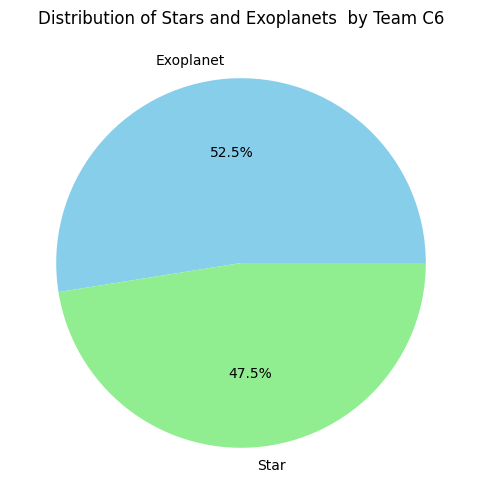

In [23]:
plt.figure(figsize=(8, 6))
plt.pie(category_counts.values, labels=category_counts.index, autopct='%1.1f%%', colors=['skyblue', 'lightgreen'])
plt.title('Distribution of Stars and Exoplanets  by Team C6')
plt.show()

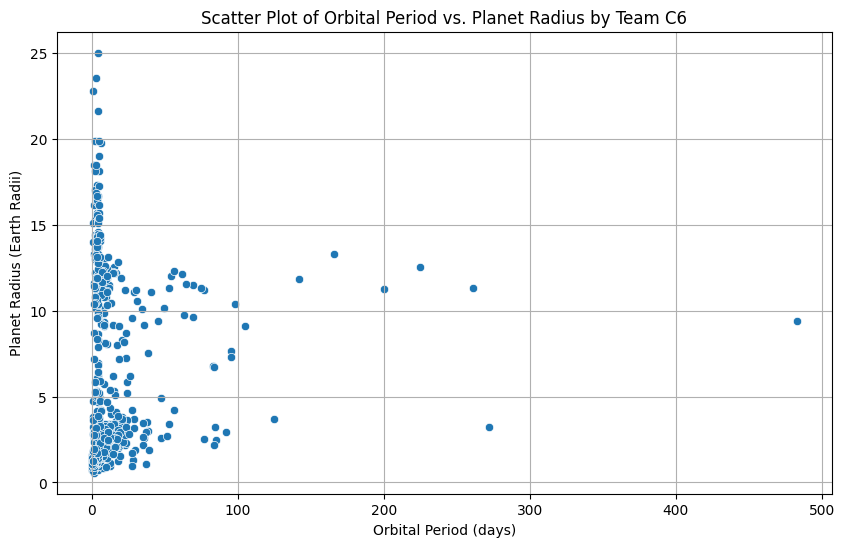

In [22]:
# Scatter Plot: Orbital Period vs. Planet Radius
plt.figure(figsize=(10, 6))
sns.scatterplot(x='pl_orbper', y='pl_rade', data=df)
plt.title('Scatter Plot of Orbital Period vs. Planet Radius by Team C6')
plt.xlabel('Orbital Period (days)')
plt.ylabel('Planet Radius (Earth Radii)')
plt.grid(True)
plt.show()

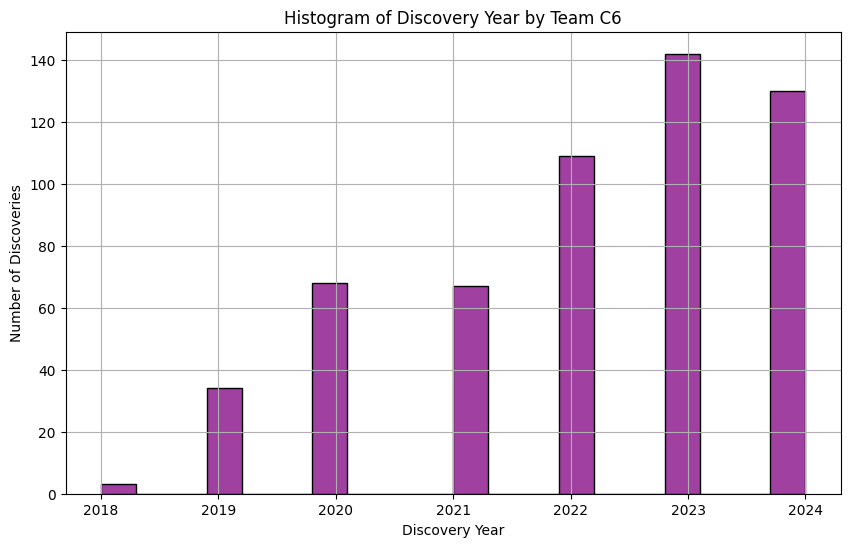

In [21]:
# Histogram: Discovery Year
plt.figure(figsize=(10, 6))
sns.histplot(df['disc_year'], bins=20, kde=False, color='purple')
plt.title('Histogram of Discovery Year by Team C6')
plt.xlabel('Discovery Year')
plt.ylabel('Number of Discoveries')
plt.grid(True)
plt.show()

In [45]:
profile = ProfileReport(combined_data, title="Profiling Report for the Exoplanet and Stars Dataset")

In [49]:
profile.to_notebook_iframe()

In [48]:
profile.to_file("profile_exosky.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]